<a href="https://colab.research.google.com/github/OJB-Quantum/Notebooks-for-Ideas/blob/main/Wave_Packet_Animation.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

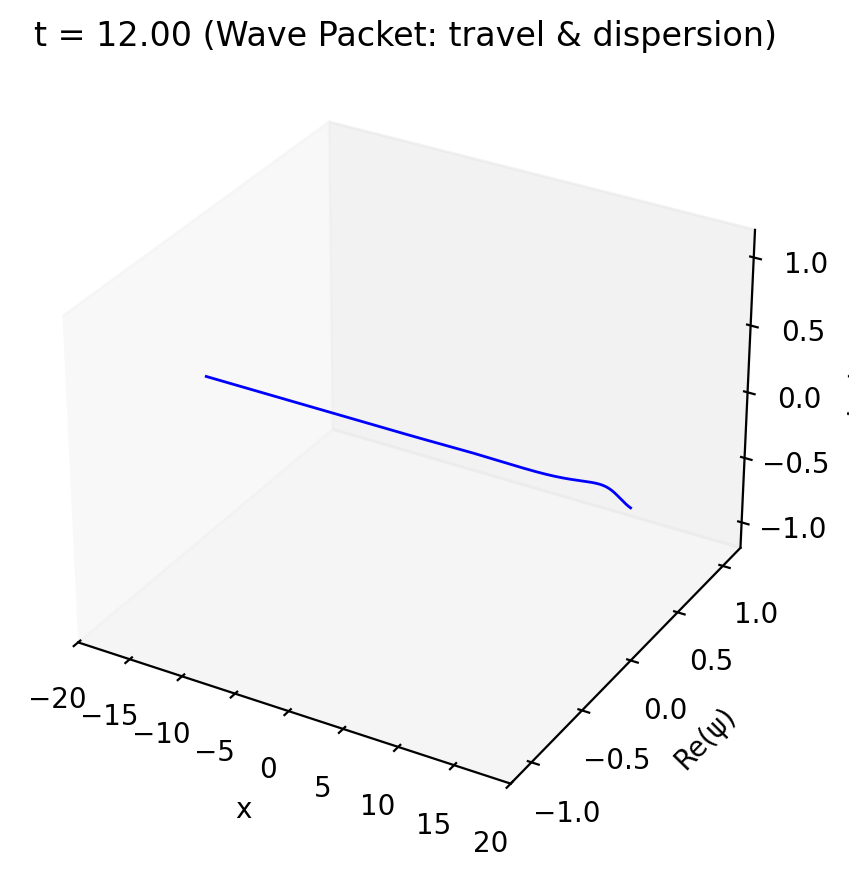

In [24]:
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

# Increase (or decrease) if you want to allow larger embedded animations
plt.rcParams['animation.embed_limit'] = 25

def psi_free_particle(x, t, x0, k0, sigma, m=1.0, hbar=1.0):
    """
    1D free-particle Gaussian wave packet with time-dependent spreading.
    """
    if t == 0:
        return np.exp(-0.5*((x - x0)/sigma)**2) * np.exp(1j * k0 * (x - x0))

    alpha = 1.0 + 1j*(hbar*t)/(m*sigma**2)
    norm = 1.0 / np.sqrt(np.sqrt(np.pi)*sigma*alpha)

    vg = (hbar*k0)/m  # group velocity
    x_shift = x - x0 - vg*t
    exponent = - (x_shift**2)/(2.0*sigma**2*alpha) + 1j*(k0*x_shift/2.0)

    return norm * np.exp(exponent)

# -----------------------------------------
# Parameters
# -----------------------------------------
x0   = -20.0
k0   = 5.0
sigma= 1.0
m    = 1.0
hbar = 1.0

tmin, tmax = 0.0, 12.0
nt         = 200
times      = np.linspace(tmin, tmax, nt)

xmin, xmax = -20, 20
nx         = 1200
x          = np.linspace(xmin, xmax, nx)

# -----------------------------------------
# Set up figure and 3D animation
# -----------------------------------------
fig = plt.figure(figsize=(7,5))
ax = fig.add_subplot(111, projection='3d')

# Remove grid lines
ax.grid(False)

line, = ax.plot([], [], [], lw=1, color='b')

ax.set_xlabel("x")
ax.set_ylabel("Re(ψ)")
ax.set_zlabel("Im(ψ)")

ax.set_xlim(xmin, xmax)
ax.set_ylim(-1.2, 1.2)
ax.set_zlim(-1.2, 1.2)

ax.set_title("Dispersing Gaussian Wave Packet (Free Particle)")

def init():
    line.set_data([], [])
    line.set_3d_properties([])
    return line,

def update(frame):
    t = times[frame]
    psi_vals = psi_free_particle(x, t, x0, k0, sigma, m=m, hbar=hbar)
    re_psi   = np.real(psi_vals)
    im_psi   = np.imag(psi_vals)

    line.set_data(x, re_psi)
    line.set_3d_properties(im_psi)

    ax.set_title(f"t = {t:.2f} (Wave Packet: travel & dispersion)")
    return line,

anim = FuncAnimation(fig, update, frames=range(nt), init_func=init, blit=True)
HTML(anim.to_jshtml())